# Many with input

asdf

$$
\begin{eqnarray*}
    \dot{z_i} & = & z_i ((\lambda_i + \mathrm{i}) + b_i |z_i|^2) + \sum_k W_{ik} z_k + K_\textrm{input} \delta_{i,i_\textrm{input}} \chi_{[t_i, t_f)}(t) \sin( 2 \pi f_\textrm{input} t ) \\
    \dot{W} & = & \alpha (I_{N_z} - \mathbf{z} \bar{\mathbf{z}}^\top)
\end{eqnarray*}
$$

In [1]:
import numpy as np
import scipy.integrate
import matplotlib.pyplot as plt

In [29]:
Nz = 20

# Hopf oscillator characteristics
l = np.random.randn( Nz )
# TODO Should the Lyopunov exponent vary across oscillators?
b = -0.1 + np.random.randn( Nz ) * 1.j

alpha = 0.001 # 0.1

In [60]:
t_input_start = 2e3
t_input_end = 2.1e3
# t_input_start = 0.
# t_input_end = 100.
input_channel = 10
input_frequency = 1.
input_magnitude = 100.

In [31]:
def deriv( t, y ):
    
    z = y[:Nz]
    W = np.reshape( y[Nz:], (Nz, Nz) )
    
    z_dot = np.zeros( z.shape[0], dtype = np.complex )
    
    for i in range( z_dot.shape[0] ):
        z_dot[i] = z[i] * ( ( l[i] + 1.j ) + b[i] * z[i] * np.conj( z[i] ) )
        
        if t >= t_input_start and t < t_input_end:
            if i == input_channel:
                z_dot[i] = z_dot[i] + input_magnitude * np.sin( 2 * np.pi * input_frequency * t )
        
        for k in range( z_dot.shape[0] ):
#             if k == i:
#                 continue
#             z_dot[i] += W[i, k] * np.real( z[k] )
            z_dot[i] += W[i, k] * z[k]
    
#     W_dot = alpha * ( np.eye( Nz ) - np.outer( np.real( z ), np.real( z ) ) )
    W_dot = alpha * ( np.eye( Nz ) - np.outer( z, np.conj( z ) ) )
    
    y_dot = np.zeros( y.shape[0], dtype = np.complex )
    y_dot[:Nz] = z_dot
    y_dot[Nz:] = W_dot.flatten()
    
    return y_dot

In [32]:
t_span = [0, 5e3]
t_eval = np.arange( t_span[0], t_span[-1], 1e-2 )

In [33]:
# TODO Randomize the z0 in an intelligent way
z0 = np.zeros( (Nz,), dtype = np.complex )
for i in range( z0.shape[0] ):
    z0[i] = 0.01 + 0.j
    
W0 = np.random.randn( Nz, Nz ) + np.random.randn( Nz, Nz ) * 1.j

y0 = np.zeros( (Nz + Nz*Nz,), dtype = np.complex )
y0[:Nz] = z0
y0[Nz:] = W0.flatten()

In [47]:
t_span = [0, 1e3]
t_eval = np.arange( t_span[0], t_span[-1], 1e-2 )

In [45]:
i_t0 = np.where( t_star >= t_input_start )[0][0]
y0 = y_star[:, i_t0]

In [52]:
sol = scipy.integrate.solve_ivp( deriv, t_span, y0,
                                 t_eval = t_eval )

In [53]:
t_star = sol.t
y_star = sol.y

z_star = y_star[:Nz, :]
W_star = np.reshape( y_star[Nz:, :], (Nz, Nz, y_star.shape[1]) )

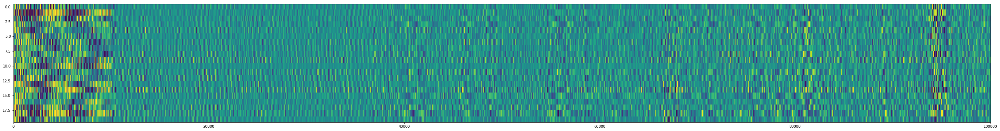

In [54]:
plt.figure( figsize = (48, 6) )
plt.imshow( np.real( z_star ), aspect = 'auto',
            vmin = np.quantile( np.real( z_star ), 0.01 ),
            vmax = np.quantile( np.real( z_star ), 0.99 ) )

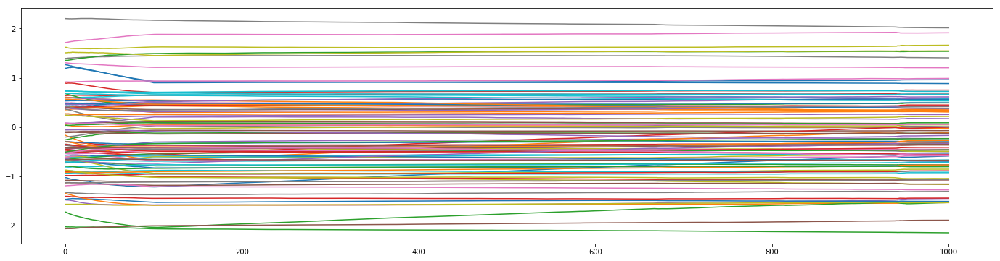

In [61]:
plt.figure( figsize = (24, 6) )
plt.plot( t_star, np.real( y_star[Nz:(Nz+100), :].T ) )
plt.show()

In [55]:
import scipy.signal

In [56]:
coherence_window = 512
coherence_window_step = 128
coherence_nfft = 512
coherence_f_min = 0.0
coherence_f_max = 0.1

coherence_starts = np.arange( 0, z_star.shape[1] - coherence_window, coherence_window_step )

coherence_traces = np.zeros( (Nz, Nz, coherence_starts.shape[0],) )

# n_shuffle = 100
# coherence_trace_shuffle = np.zeros( (n_shuffle, coherence_trace.shape[0]) )

for i in range( Nz ):
    print( 'Starting row {0}'.format( i ) )
    for j in range( Nz ):
        for i_start, cur_start in enumerate( coherence_starts ):
            cur_end = cur_start + coherence_window
            cur_data_i = np.real( z_star[i, cur_start:cur_end] )
            cur_data_j = np.real( z_star[j, cur_start:cur_end] )

            f, Cxy = scipy.signal.coherence( cur_data_i, cur_data_j, nfft = coherence_nfft )
            coherence_traces[i, j, i_start] = np.mean( Cxy[(f >= coherence_f_min) & (f < coherence_f_max)] )

        #     for i_shuffle in range( n_shuffle ):
        #         np.random.shuffle( cur_data_i )
        #         np.random.shuffle( cur_data_j )

        #         f, Cxy = scipy.signal.coherence( cur_data_i, cur_data_j, nfft = coherence_nfft )
        #         coherence_trace_shuffle[i_shuffle, i_start] = np.mean( Cxy[(f >= coherence_f_min) & (f < coherence_f_max)] )
        
print( 'Done.' )

Starting row 0
Starting row 1
Starting row 2
Starting row 3
Starting row 4
Starting row 5
Starting row 6
Starting row 7
Starting row 8
Starting row 9
Starting row 10
Starting row 11
Starting row 12
Starting row 13
Starting row 14
Starting row 15
Starting row 16
Starting row 17
Starting row 18
Starting row 19
Done.


In [57]:
coherence_centers = coherence_starts + coherence_window / 2

In [58]:
coherence_traces_list = []
coherence_pair_list = []
for i in range( Nz ):
    for j in range( i+1, Nz ):
        coherence_traces_list.append( coherence_traces[i, j, :] )
        coherence_pair_list.append( (i, j) )

coherence_traces_linear = np.zeros( (len( coherence_traces_list ), coherence_traces_list[0].shape[0]) )
for i, trace in enumerate( coherence_traces_list ):
    coherence_traces_linear[i, :] = trace

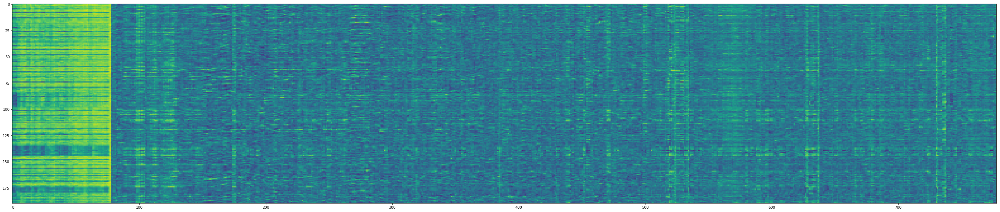

In [59]:
plt.figure( figsize = (48, 10) )
plt.imshow( coherence_traces_linear, aspect = 'auto' )
plt.clim( 0, 1 )

Run 1
    Solving ODE...Done.


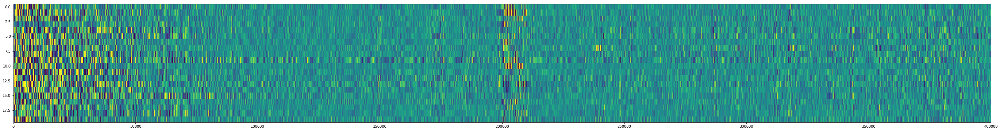

    Computing coherence...
        Starting row 0...
        Starting row 1...
        Starting row 2...
        Starting row 3...
        Starting row 4...
        Starting row 5...
        Starting row 6...
        Starting row 7...
        Starting row 8...
        Starting row 9...
        Starting row 10...
        Starting row 11...
        Starting row 12...
        Starting row 13...
        Starting row 14...
        Starting row 15...
        Starting row 16...
        Starting row 17...
        Starting row 18...
        Starting row 19...
        Done.
Run 2
    Solving ODE...Done.


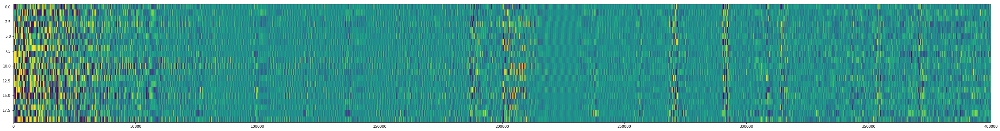

    Computing coherence...
        Starting row 0...
        Starting row 1...
        Starting row 2...
        Starting row 3...
        Starting row 4...
        Starting row 5...
        Starting row 6...
        Starting row 7...
        Starting row 8...
        Starting row 9...
        Starting row 10...
        Starting row 11...
        Starting row 12...
        Starting row 13...
        Starting row 14...
        Starting row 15...
        Starting row 16...
        Starting row 17...
        Starting row 18...
        Starting row 19...
        Done.
Run 3
    Solving ODE...Done.


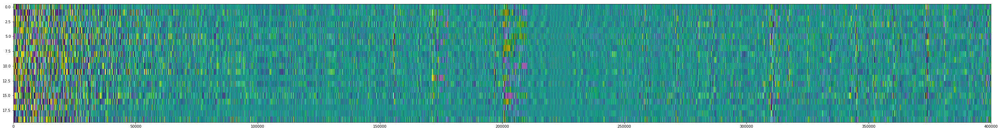

    Computing coherence...
        Starting row 0...
        Starting row 1...
        Starting row 2...
        Starting row 3...
        Starting row 4...
        Starting row 5...
        Starting row 6...
        Starting row 7...
        Starting row 8...
        Starting row 9...
        Starting row 10...
        Starting row 11...
        Starting row 12...
        Starting row 13...
        Starting row 14...
        Starting row 15...
        Starting row 16...
        Starting row 17...
        Starting row 18...
        Starting row 19...
        Done.
Run 4
    Solving ODE...Done.


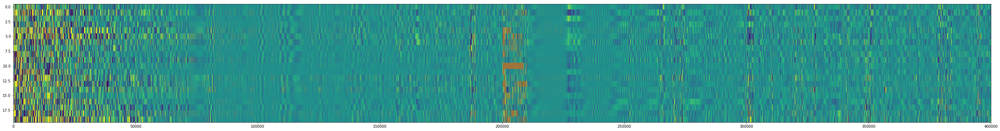

    Computing coherence...
        Starting row 0...
        Starting row 1...
        Starting row 2...
        Starting row 3...
        Starting row 4...
        Starting row 5...
        Starting row 6...
        Starting row 7...
        Starting row 8...
        Starting row 9...
        Starting row 10...
        Starting row 11...
        Starting row 12...
        Starting row 13...
        Starting row 14...
        Starting row 15...
        Starting row 16...
        Starting row 17...
        Starting row 18...
        Starting row 19...
        Done.
Run 5
    Solving ODE...Done.


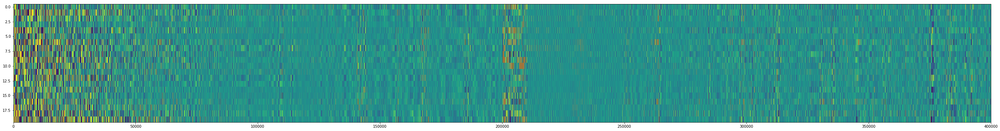

    Computing coherence...
        Starting row 0...
        Starting row 1...
        Starting row 2...
        Starting row 3...
        Starting row 4...
        Starting row 5...
        Starting row 6...
        Starting row 7...
        Starting row 8...
        Starting row 9...
        Starting row 10...
        Starting row 11...
        Starting row 12...
        Starting row 13...
        Starting row 14...
        Starting row 15...
        Starting row 16...
        Starting row 17...
        Starting row 18...
        Starting row 19...
        Done.
Run 6
    Solving ODE...Done.


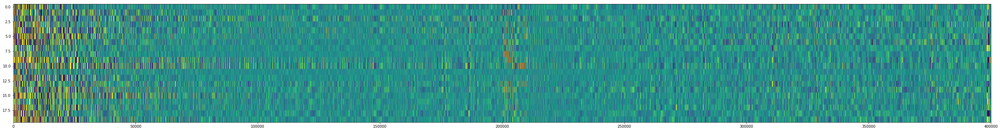

    Computing coherence...
        Starting row 0...
        Starting row 1...
        Starting row 2...
        Starting row 3...
        Starting row 4...
        Starting row 5...
        Starting row 6...
        Starting row 7...
        Starting row 8...
        Starting row 9...
        Starting row 10...
        Starting row 11...
        Starting row 12...
        Starting row 13...
        Starting row 14...
        Starting row 15...
        Starting row 16...
        Starting row 17...
        Starting row 18...
        Starting row 19...
        Done.
Run 7
    Solving ODE...Done.


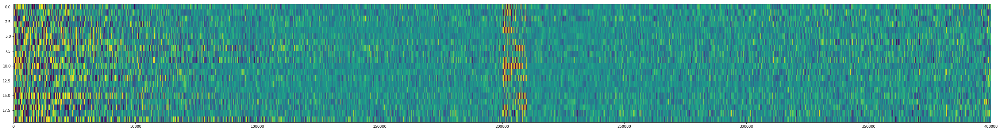

    Computing coherence...
        Starting row 0...
        Starting row 1...
        Starting row 2...
        Starting row 3...
        Starting row 4...
        Starting row 5...
        Starting row 6...
        Starting row 7...
        Starting row 8...
        Starting row 9...
        Starting row 10...
        Starting row 11...
        Starting row 12...
        Starting row 13...
        Starting row 14...
        Starting row 15...
        Starting row 16...
        Starting row 17...
        Starting row 18...
        Starting row 19...
        Done.
Run 8
    Solving ODE...Done.


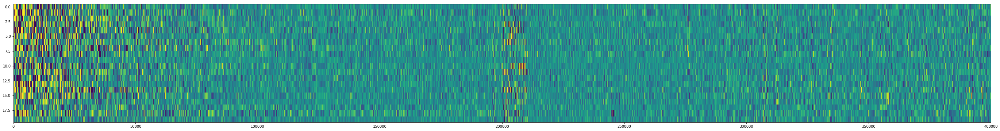

    Computing coherence...
        Starting row 0...
        Starting row 1...
        Starting row 2...
        Starting row 3...
        Starting row 4...
        Starting row 5...
        Starting row 6...
        Starting row 7...
        Starting row 8...
        Starting row 9...
        Starting row 10...
        Starting row 11...
        Starting row 12...
        Starting row 13...
        Starting row 14...
        Starting row 15...
        Starting row 16...
        Starting row 17...
        Starting row 18...
        Starting row 19...
        Done.
Run 9
    Solving ODE...Done.


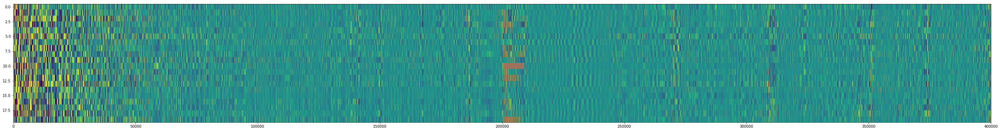

    Computing coherence...
        Starting row 0...
        Starting row 1...
        Starting row 2...
        Starting row 3...
        Starting row 4...
        Starting row 5...
        Starting row 6...
        Starting row 7...
        Starting row 8...
        Starting row 9...
        Starting row 10...
        Starting row 11...
        Starting row 12...
        Starting row 13...
        Starting row 14...
        Starting row 15...
        Starting row 16...
        Starting row 17...
        Starting row 18...
        Starting row 19...
        Done.
Run 10
    Solving ODE...Done.


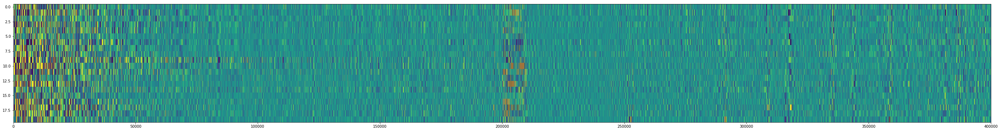

    Computing coherence...
        Starting row 0...
        Starting row 1...
        Starting row 2...
        Starting row 3...
        Starting row 4...
        Starting row 5...
        Starting row 6...
        Starting row 7...
        Starting row 8...
        Starting row 9...
        Starting row 10...
        Starting row 11...
        Starting row 12...
        Starting row 13...
        Starting row 14...
        Starting row 15...
        Starting row 16...
        Starting row 17...
        Starting row 18...
        Starting row 19...
        Done.
Run 11
    Solving ODE...Done.


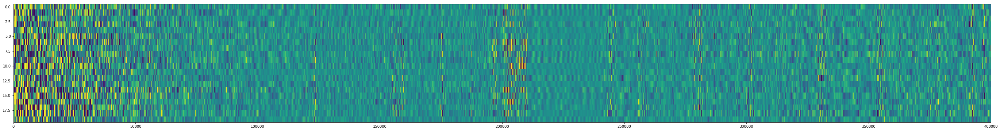

    Computing coherence...
        Starting row 0...
        Starting row 1...
        Starting row 2...
        Starting row 3...
        Starting row 4...
        Starting row 5...
        Starting row 6...
        Starting row 7...
        Starting row 8...
        Starting row 9...
        Starting row 10...
        Starting row 11...
        Starting row 12...
        Starting row 13...
        Starting row 14...
        Starting row 15...
        Starting row 16...
        Starting row 17...
        Starting row 18...
        Starting row 19...
        Done.
Run 12
    Solving ODE...Done.


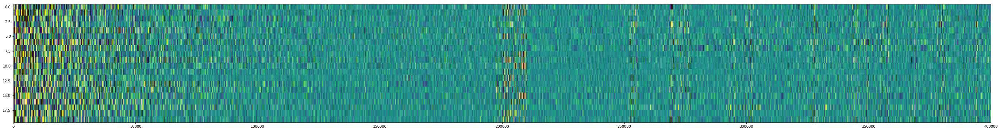

    Computing coherence...
        Starting row 0...
        Starting row 1...
        Starting row 2...
        Starting row 3...
        Starting row 4...
        Starting row 5...
        Starting row 6...
        Starting row 7...
        Starting row 8...
        Starting row 9...
        Starting row 10...
        Starting row 11...
        Starting row 12...
        Starting row 13...
        Starting row 14...
        Starting row 15...
        Starting row 16...
        Starting row 17...
        Starting row 18...
        Starting row 19...
        Done.
Done.


In [110]:
n_sim = 12

t_span = [0, 4e3]
t_eval = np.arange( t_span[0], t_span[-1], 1e-2 )

t_input_start = 2e3
t_input_end = 2.1e3 # 3e3 # 2.1e3
input_channel = 10
input_frequency = 1.
input_magnitude = 100.

def deriv( t, y ):
    
    z = y[:Nz]
    W = np.reshape( y[Nz:], (Nz, Nz) )
    
    z_dot = np.zeros( z.shape[0], dtype = np.complex )
    
    for i in range( z_dot.shape[0] ):
        z_dot[i] = z[i] * ( ( l[i] + 1.j ) + b[i] * z[i] * np.conj( z[i] ) )
        
        if t >= t_input_start and t < t_input_end:
            if i == input_channel:
                z_dot[i] = z_dot[i] + input_magnitude * np.sin( 2 * np.pi * input_frequency * t )
        
        for k in range( z_dot.shape[0] ):
#             if k == i:
#                 continue
#             z_dot[i] += W[i, k] * np.real( z[k] )
            z_dot[i] += W[i, k] * z[k]
    
#     W_dot = alpha * ( np.eye( Nz ) - np.outer( np.real( z ), np.real( z ) ) )
    W_dot = alpha * ( np.eye( Nz ) - np.outer( z, np.conj( z ) ) )
    
    y_dot = np.zeros( y.shape[0], dtype = np.complex )
    y_dot[:Nz] = z_dot
    y_dot[Nz:] = W_dot.flatten()
    
    return y_dot

coherence_window = 512
coherence_window_step = 128
coherence_nfft = 512
coherence_f_min = 0.0
coherence_f_max = 0.1
coherence_starts = np.arange( 0, z_star.shape[1] - coherence_window, coherence_window_step )

alpha = 0.001

# coherence_results = []

for i_sim in range( n_sim ):
    
    print( 'Run {0}'.format( i_sim + 1 ) )
    
    # Hopf oscillator characteristics
    l = np.random.randn( Nz )
    # TODO Should the Lyopunov exponent vary across oscillators?
    b = -0.1 + np.random.randn( Nz ) * 1.j
    
    # TODO Randomize the z0 in an intelligent way
    z0 = np.zeros( (Nz,), dtype = np.complex )
    for i in range( z0.shape[0] ):
        z0[i] = 0.01 + 0.j

    W0 = np.random.randn( Nz, Nz ) + np.random.randn( Nz, Nz ) * 1.j

    y0 = np.zeros( (Nz + Nz*Nz,), dtype = np.complex )
    y0[:Nz] = z0
    y0[Nz:] = W0.flatten()
    
    print( '    Solving ODE...', end = '' )
    sol = scipy.integrate.solve_ivp( deriv, t_span, y0,
                                     t_eval = t_eval )
    print( 'Done.' )
    
    t_star = sol.t
    y_star = sol.y

    z_star = y_star[:Nz, :]
    W_star = np.reshape( y_star[Nz:, :], (Nz, Nz, y_star.shape[1]) )

    plt.figure( figsize = (48, 6) )
    plt.imshow( np.real( z_star ), aspect = 'auto',
                vmin = np.quantile( np.real( z_star ), 0.01 ),
                vmax = np.quantile( np.real( z_star ), 0.99 ) )
    plt.show()
    
    coherence_traces = np.zeros( (Nz, Nz, coherence_starts.shape[0],) )

    print( '    Computing coherence...' )
    for i in range( Nz ):
        print( '        Starting row {0}...'.format( i ) )
        for j in range( Nz ):
            for i_start, cur_start in enumerate( coherence_starts ):
                cur_end = cur_start + coherence_window
                cur_data_i = np.real( z_star[i, cur_start:cur_end] )
                cur_data_j = np.real( z_star[j, cur_start:cur_end] )

                f, Cxy = scipy.signal.coherence( cur_data_i, cur_data_j, nfft = coherence_nfft )
                coherence_traces[i, j, i_start] = np.mean( Cxy[(f >= coherence_f_min) & (f < coherence_f_max)] )
                
    coherence_results.append( coherence_traces )
                
    print( '        Done.' )
    
print( 'Done.' )

In [114]:
coherence_centers = coherence_starts + coherence_window / 2

In [115]:
coherence_results_linear = None

for i_run in range( len( coherence_results ) ):
    coherence_traces_list = []
    coherence_pair_list = []
    for i in range( Nz ):
        for j in range( i+1, Nz ):
            coherence_traces_list.append( coherence_results[i_run][i, j, :] )
            coherence_pair_list.append( (i, j) )

    coherence_traces_linear = np.zeros( (len( coherence_traces_list ), coherence_traces_list[0].shape[0]) )
    for i, trace in enumerate( coherence_traces_list ):
        coherence_traces_linear[i, :] = trace
        
    if coherence_results_linear is None:
        coherence_results_linear = np.zeros( (len( coherence_results ), coherence_traces_linear.shape[0], coherence_traces_linear.shape[1]) )
    coherence_results_linear[i_run, :, :] = coherence_traces_linear

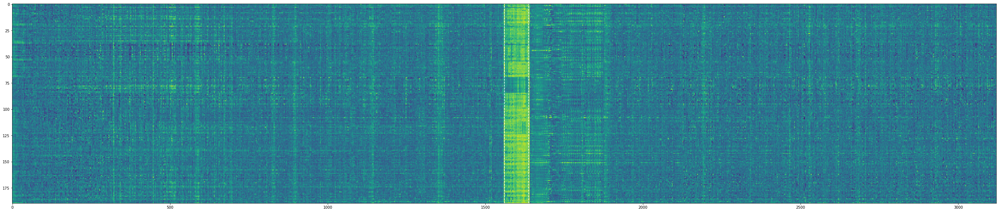

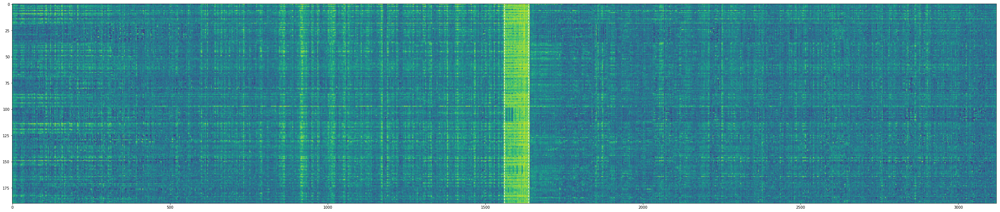

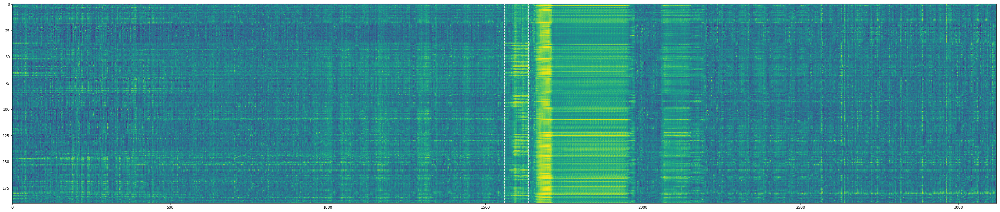

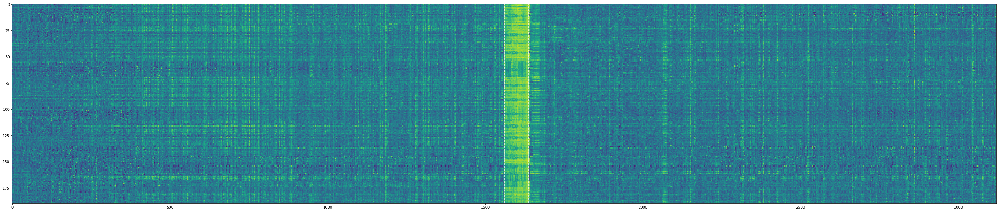

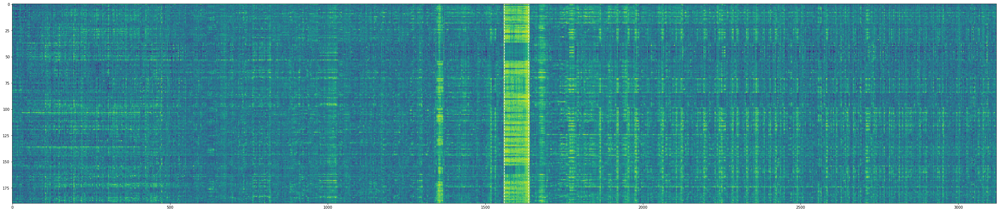

...

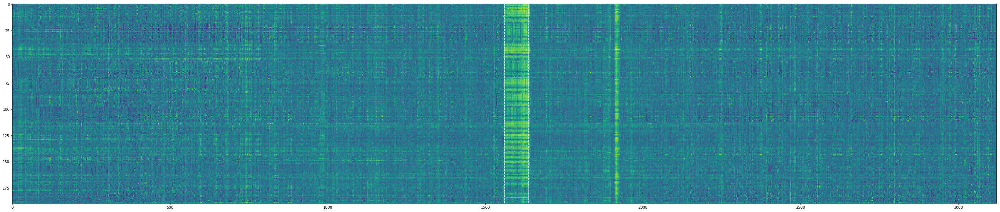

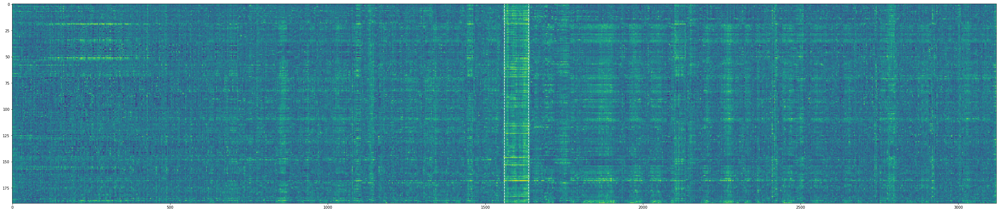

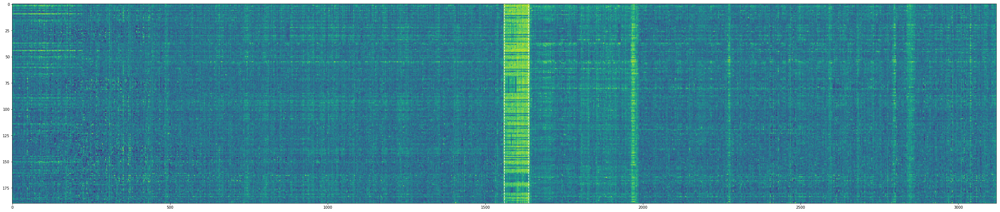

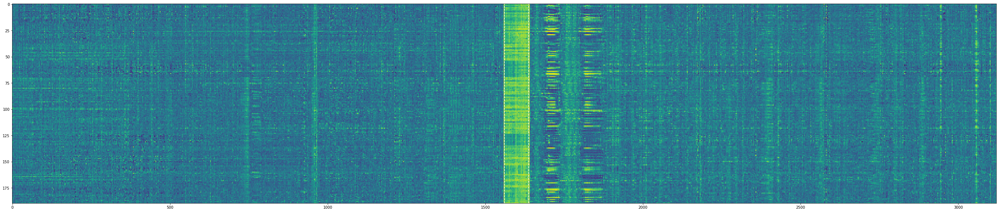

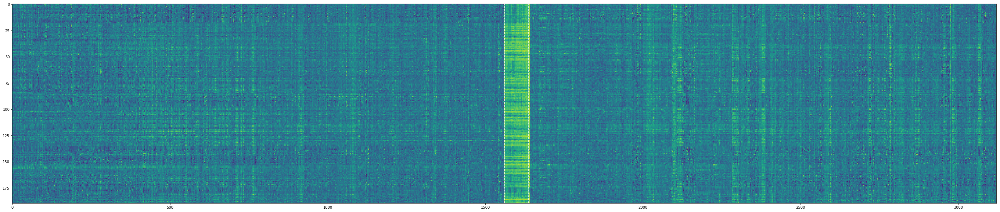

In [117]:
for i in range( coherence_results_linear.shape[0] ):
    plt.figure( figsize = (48, 10) )
    plt.imshow( coherence_results_linear[i, :, :], aspect = 'auto' )
    
    sample_start = np.min( np.where( (coherence_centers / 1e2) >= t_input_start )[0] )
    sample_end = np.max( np.where( (coherence_centers / 1e2) < t_input_end )[0] )
    yl = plt.ylim()
    plt.plot( sample_start * np.array( [1, 1] ), yl, 'w--' )
    plt.plot( sample_end * np.array( [1, 1] ), yl, 'w--' )
    
    plt.clim( 0, 1 )
    
    plt.show()

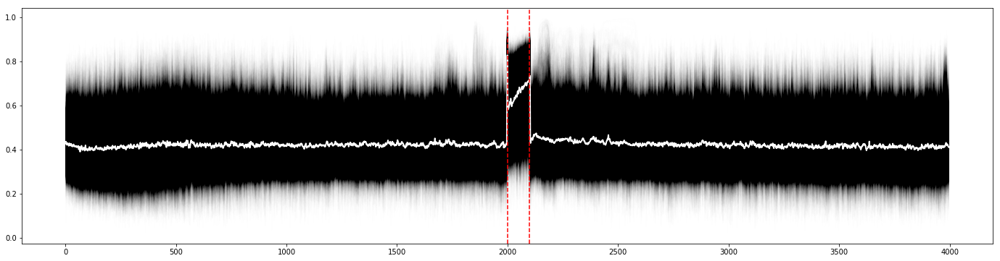

In [113]:
plt.figure( figsize = (24, 6) )
plt.plot( coherence_centers / 1e2, coherence_results_linear.reshape( (coherence_results_linear.shape[0] * coherence_results_linear.shape[1], coherence_results_linear.shape[2]) ).T, 'k-', alpha = 0.005 )
plt.plot( coherence_centers / 1e2, np.median( coherence_results_linear, axis = (0, 1) ), 'w-', linewidth = 2 )

yl = plt.ylim()
plt.plot( t_input_start * np.array( [1, 1] ), yl, 'r--' )
plt.plot( t_input_end * np.array( [1, 1] ), yl, 'r--' )
plt.ylim( yl )

plt.show()

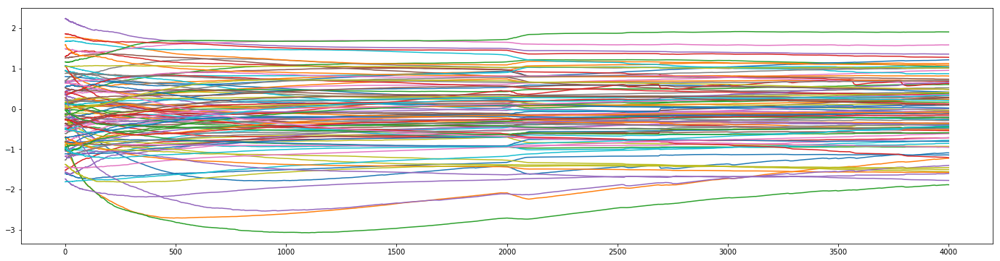

In [118]:
plt.figure( figsize = (24, 6) )
plt.plot( t_star, np.real( y_star[Nz:(Nz+100), :].T ) )
plt.show()